In the week 4 assignment, I will replace the data I used in the week 3 assignment with the data related to my project proposal. I will show the wildfire planning effectiveness scores in 58 California counties.

# Data Management

In [1]:
# import all the tools
import pandas as pd
import geopandas as gpd
import folium
import matplotlib.pyplot as plt
import contextily as ctx
import branca.colormap as cm

In [2]:
# read in a geojson file 
tracts = gpd.read_file('California_County_Boundaries.geojson')
tracts.head()

,OBJECTID,CountyName,AdminRegion,FireMAR,LawMAR,State_FIPS_ID,County_FIPS_ID,Shape__Area,Shape__Length,geometry
0,1,Alameda,Coastal,2,2,06,001,3.082165e+09,432059.180712,"MULTIPOLYGON (((-122.26853 37.90446, -122.2682..."
1,2,Alpine,Inland,4,4,06,003,3.145871e+09,274621.121060,"POLYGON ((-119.93433 38.80882, -119.93426 38.8..."
2,3,Amador,Inland,4,4,06,005,2.559998e+09,357482.565247,"POLYGON ((-120.25766 38.58033, -120.25735 38.5..."
3,4,Butte,Inland,3,3,06,007,7.338660e+09,526729.272631,"POLYGON ((-121.63427 40.00127, -121.63428 40.0..."
4,5,Calaveras,Inland,4,4,06,009,4.352160e+09,371781.055548,"POLYGON ((-120.20981 38.50033, -120.20961 38.5..."


In [3]:
# load wildfire planning effective score csv
df = pd.read_csv('58 counties_240209_TRANSPOSED 7.csv')
df.head()

,CASE_LBL,LU_SUM,CIR_SUM,HS_SUM,CSV_SUM,OS_SUM,SFT_SUM,EJ_SUM,K_9.1,GP_SUM,...,WSVI_SUM,WSVI_GP,WSVI_CWPP,WSVI_HMP,VAR00009,GP_TOTAL,CWPP_TOTAL,HMP_TOTAL,THREEPLANS_TOTAL,FIPS_ID
0,ALAMEDA_01,3,3,6,4,0,19.0,1.5,2,38.5,...,0.47,0.28,0.50,0.63,,38.5,49.05,48.98,0.73,1
1,ALPINE_02,2,3,7,6,0,14.0,1.5,1,34.5,...,0.16,0.24,0.00,0.25,,34.5,52.38,46.98,0.72,3
2,AMADOR_03,3,4,4,6,1,19.5,1.5,1,40.0,...,0.38,0.14,0.00,1.00,,40.0,37.05,58.98,0.73,5
3,BUTTE_04,4,4,5,4,2,20.5,6.0,2,47.5,...,0.59,0.78,0.00,1.00,,47.5,34.73,55.98,0.74,7
4,CALAVERAS_05,4,4,5,7,1,19.0,2.5,1,43.5,...,0.76,0.52,0.75,1.00,,43.5,55.05,52.98,0.81,9


In [4]:
df['County_FIPS_ID'] = tracts['County_FIPS_ID'].values
df.head()

,CASE_LBL,LU_SUM,CIR_SUM,HS_SUM,CSV_SUM,OS_SUM,SFT_SUM,EJ_SUM,K_9.1,GP_SUM,...,WSVI_GP,WSVI_CWPP,WSVI_HMP,VAR00009,GP_TOTAL,CWPP_TOTAL,HMP_TOTAL,THREEPLANS_TOTAL,FIPS_ID,County_FIPS_ID
0,ALAMEDA_01,3,3,6,4,0,19.0,1.5,2,38.5,...,0.28,0.50,0.63,,38.5,49.05,48.98,0.73,1,001
1,ALPINE_02,2,3,7,6,0,14.0,1.5,1,34.5,...,0.24,0.00,0.25,,34.5,52.38,46.98,0.72,3,003
2,AMADOR_03,3,4,4,6,1,19.5,1.5,1,40.0,...,0.14,0.00,1.00,,40.0,37.05,58.98,0.73,5,005
3,BUTTE_04,4,4,5,4,2,20.5,6.0,2,47.5,...,0.78,0.00,1.00,,47.5,34.73,55.98,0.74,7,007
4,CALAVERAS_05,4,4,5,7,1,19.0,2.5,1,43.5,...,0.52,0.75,1.00,,43.5,55.05,52.98,0.81,9,009


In [5]:
df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58 entries, 0 to 57
Data columns (total 59 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   CASE_LBL          58 non-null     object 
 1   LU_SUM            58 non-null     int64  
 2   CIR_SUM           58 non-null     int64  
 3   HS_SUM            58 non-null     int64  
 4   CSV_SUM           58 non-null     int64  
 5   OS_SUM            58 non-null     int64  
 6   SFT_SUM           58 non-null     float64
 7   EJ_SUM            58 non-null     float64
 8   K_9.1             58 non-null     int64  
 9   GP_SUM            58 non-null     float64
 10  CTX_SUM           58 non-null     object 
 11  CLB_SUM           58 non-null     object 
 12  FR_SUM            58 non-null     object 
 13  SI_SUM            58 non-null     object 
 14  STIM_SUM          58 non-null     object 
 15  ME_SUM            58 non-null     object 
 16  VP_SUM            58 non-null     object 
 17 

# Mapping_static

<Axes: >

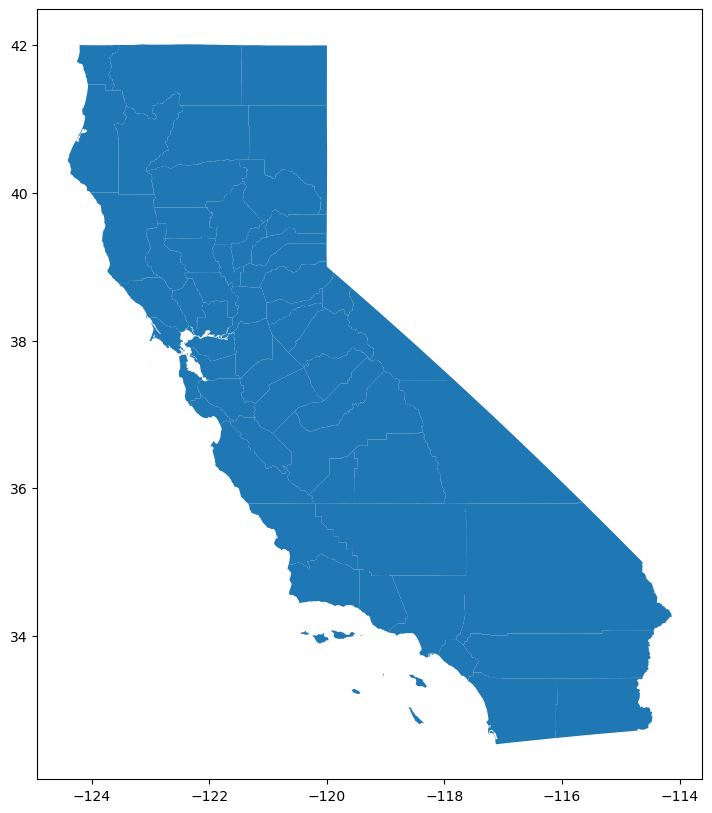

In [6]:
# plot it
tracts.plot(figsize=(12,10))

In [7]:
mapping = tracts.merge(df, on="County_FIPS_ID")
mapping.head()

,OBJECTID,CountyName,AdminRegion,FireMAR,LawMAR,State_FIPS_ID,County_FIPS_ID,Shape__Area,Shape__Length,geometry,...,WSVI_SUM,WSVI_GP,WSVI_CWPP,WSVI_HMP,VAR00009,GP_TOTAL,CWPP_TOTAL,HMP_TOTAL,THREEPLANS_TOTAL,FIPS_ID
0,1,Alameda,Coastal,2,2,06,001,3.082165e+09,432059.180712,"MULTIPOLYGON (((-122.26853 37.90446, -122.2682...",...,0.47,0.28,0.50,0.63,,38.5,49.05,48.98,0.73,1
1,2,Alpine,Inland,4,4,06,003,3.145871e+09,274621.121060,"POLYGON ((-119.93433 38.80882, -119.93426 38.8...",...,0.16,0.24,0.00,0.25,,34.5,52.38,46.98,0.72,3
2,3,Amador,Inland,4,4,06,005,2.559998e+09,357482.565247,"POLYGON ((-120.25766 38.58033, -120.25735 38.5...",...,0.38,0.14,0.00,1.00,,40.0,37.05,58.98,0.73,5
3,4,Butte,Inland,3,3,06,007,7.338660e+09,526729.272631,"POLYGON ((-121.63427 40.00127, -121.63428 40.0...",...,0.59,0.78,0.00,1.00,,47.5,34.73,55.98,0.74,7
4,5,Calaveras,Inland,4,4,06,009,4.352160e+09,371781.055548,"POLYGON ((-120.20981 38.50033, -120.20961 38.5...",...,0.76,0.52,0.75,1.00,,43.5,55.05,52.98,0.81,9


<Axes: >

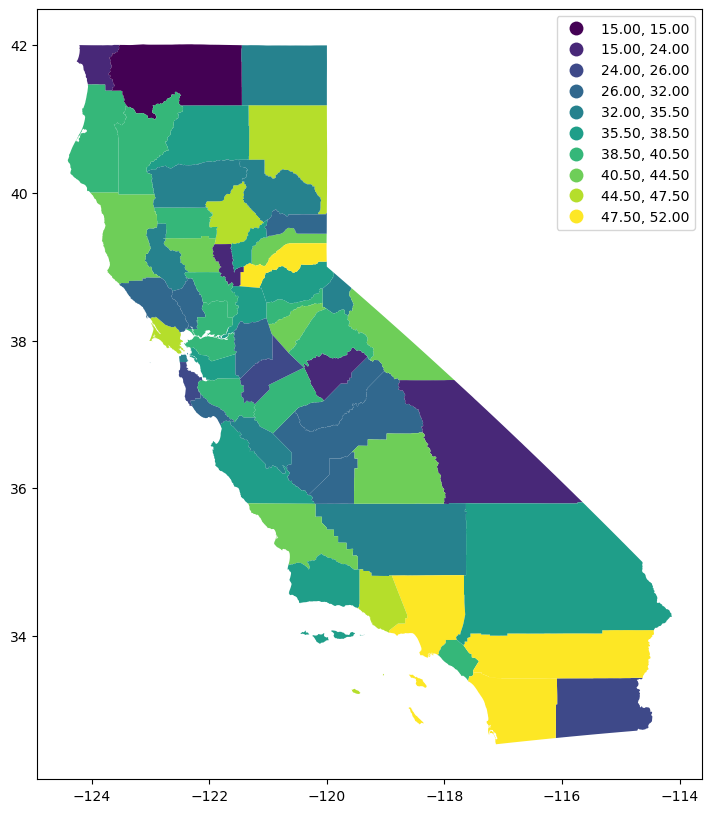

In [8]:
mapping.plot(figsize=(12,10),
                 column='GP_TOTAL',
                 legend=True, 
                 scheme='NaturalBreaks', k=10)

In [9]:
#descriptive data & chart
mapping['GP_TOTAL'].describe()


count    58.000000
mean     36.706897
std       7.894054
min      15.000000
25%      31.625000
50%      37.750000
75%      41.250000
max      52.000000
Name: GP_TOTAL, dtype: float64

<Axes: xlabel='CountyName'>

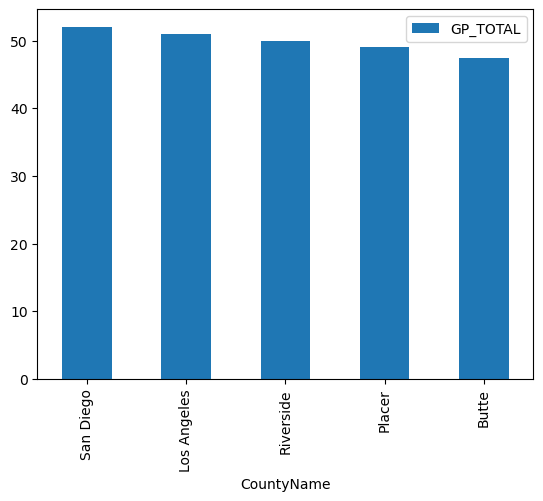

In [10]:
mapping_sorted_GP = mapping.sort_values(by='GP_TOTAL',ascending = False)
mapping_sorted_GP.head(5).plot.bar(x='CountyName',
                            y='GP_TOTAL'
                          )

<Axes: >

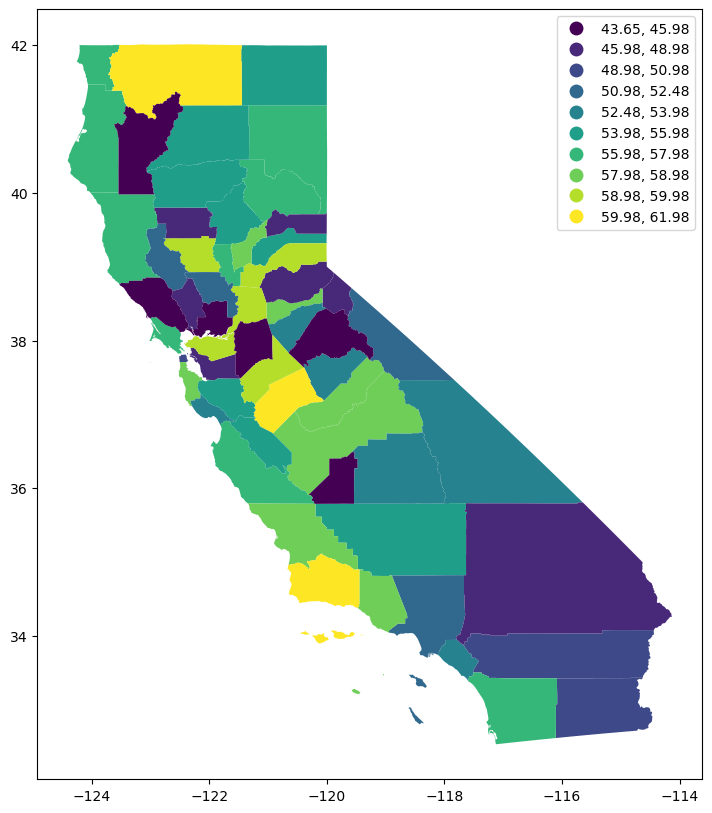

In [11]:
mapping.plot(figsize=(12,10),
                 column='HMP_TOTAL',
                 legend=True, 
                 scheme='NaturalBreaks', k=10)

In [12]:
#descriptive data & chart
mapping['HMP_TOTAL'].describe()

count    58.000000
mean     54.322586
std       4.978799
min      43.650000
25%      50.980000
50%      55.980000
75%      58.730000
max      61.980000
Name: HMP_TOTAL, dtype: float64

<Axes: xlabel='CountyName'>

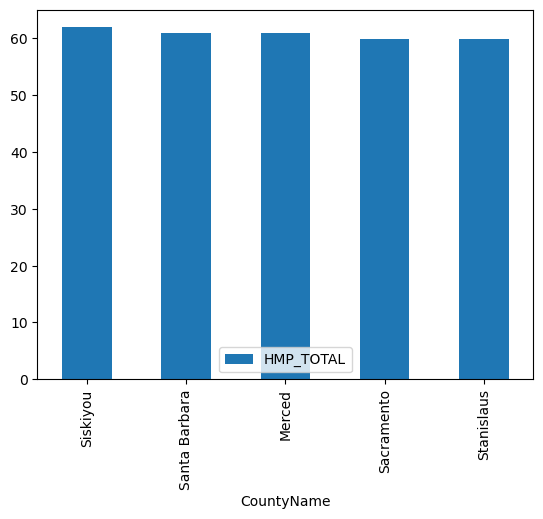

In [13]:
mapping_sorted_HMP = mapping.sort_values(by='HMP_TOTAL',ascending = False)
mapping_sorted_HMP.head(5).plot.bar(x='CountyName',
                            y='HMP_TOTAL'
                          )

<Axes: >

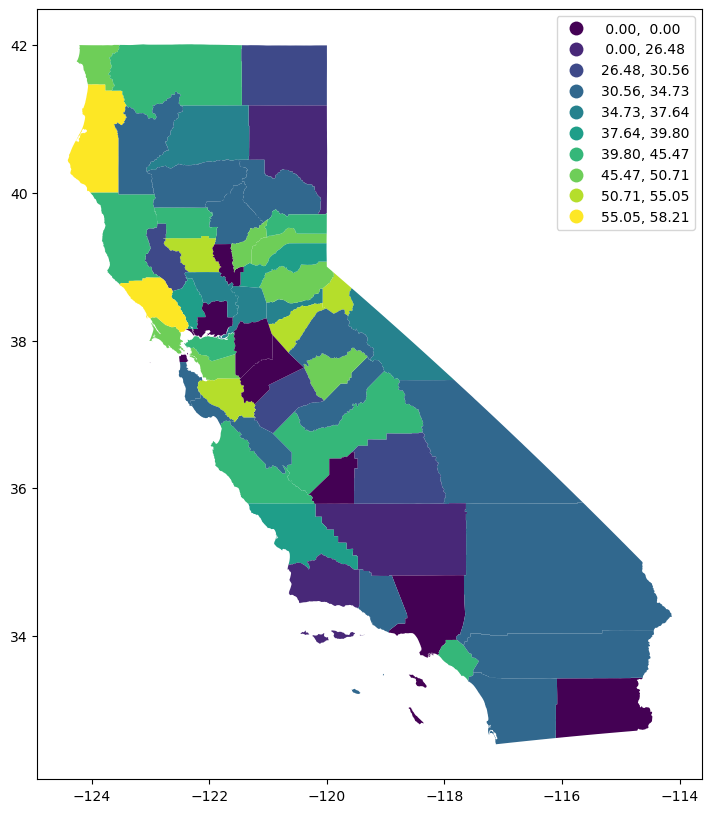

In [14]:
mapping.plot(figsize=(12,10),
                 column='CWPP_TOTAL',
                 legend=True, 
                 scheme='NaturalBreaks', k=10)

In [15]:
#descriptive data & chart
mapping['CWPP_TOTAL'].describe()

count    58.000000
mean     34.343793
std      16.149345
min       0.000000
25%      30.792500
50%      35.390000
75%      45.237500
max      58.210000
Name: CWPP_TOTAL, dtype: float64

<Axes: xlabel='CountyName'>

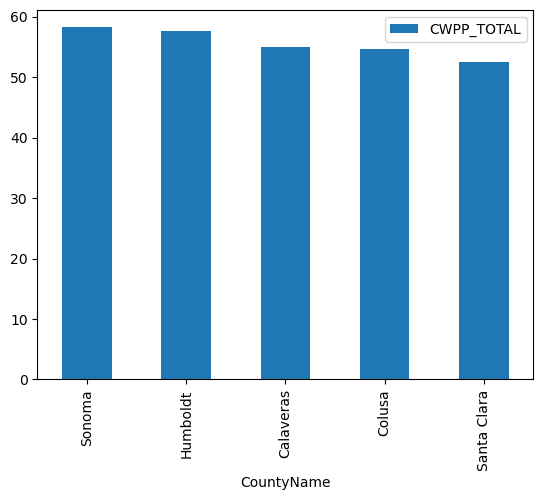

In [16]:
mapping_sorted_CWPP = mapping.sort_values(by='CWPP_TOTAL',ascending = False)
mapping_sorted_CWPP.head(5).plot.bar(x='CountyName',
                            y='CWPP_TOTAL'
                          )

<Axes: >

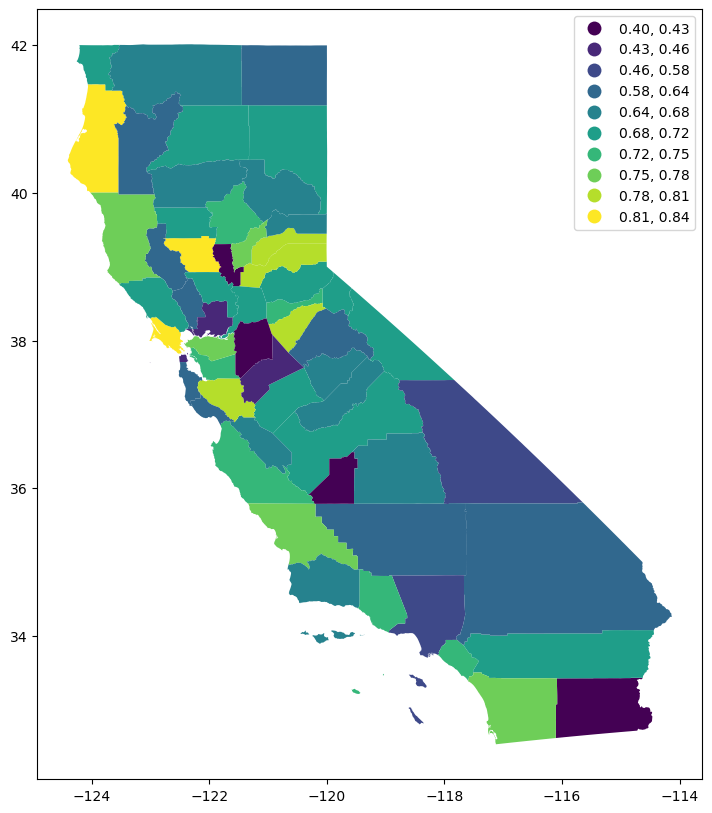

In [17]:
mapping.plot(figsize=(12,10),
                 column='THREEPLANS_TOTAL',
                 legend=True, 
                 scheme='NaturalBreaks', k=10)

# Mapping_interactive

In [18]:
pip install mapclassify

Note: you may need to restart the kernel to use updated packages.


In [19]:
import mapclassify

In [20]:
# Classify data
classifier = mapclassify.NaturalBreaks(y=mapping['THREEPLANS_TOTAL'], k=10)

# Add classified data back to GeoDataFrame
mapping['classified'] = classifier.yb
mapping.head()

,OBJECTID,CountyName,AdminRegion,FireMAR,LawMAR,State_FIPS_ID,County_FIPS_ID,Shape__Area,Shape__Length,geometry,...,WSVI_GP,WSVI_CWPP,WSVI_HMP,VAR00009,GP_TOTAL,CWPP_TOTAL,HMP_TOTAL,THREEPLANS_TOTAL,FIPS_ID,classified
0,1,Alameda,Coastal,2,2,06,001,3.082165e+09,432059.180712,"MULTIPOLYGON (((-122.26853 37.90446, -122.2682...",...,0.28,0.50,0.63,,38.5,49.05,48.98,0.73,1,6
1,2,Alpine,Inland,4,4,06,003,3.145871e+09,274621.121060,"POLYGON ((-119.93433 38.80882, -119.93426 38.8...",...,0.24,0.00,0.25,,34.5,52.38,46.98,0.72,3,5
2,3,Amador,Inland,4,4,06,005,2.559998e+09,357482.565247,"POLYGON ((-120.25766 38.58033, -120.25735 38.5...",...,0.14,0.00,1.00,,40.0,37.05,58.98,0.73,5,6
3,4,Butte,Inland,3,3,06,007,7.338660e+09,526729.272631,"POLYGON ((-121.63427 40.00127, -121.63428 40.0...",...,0.78,0.00,1.00,,47.5,34.73,55.98,0.74,7,6
4,5,Calaveras,Inland,4,4,06,009,4.352160e+09,371781.055548,"POLYGON ((-120.20981 38.50033, -120.20961 38.5...",...,0.52,0.75,1.00,,43.5,55.05,52.98,0.81,9,8


In [21]:
# check the data, specifically for the latitude and longitude columns
mapping.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 58 entries, 0 to 57
Data columns (total 69 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   OBJECTID          58 non-null     int64   
 1   CountyName        58 non-null     object  
 2   AdminRegion       58 non-null     object  
 3   FireMAR           58 non-null     object  
 4   LawMAR            58 non-null     object  
 5   State_FIPS_ID     58 non-null     object  
 6   County_FIPS_ID    58 non-null     object  
 7   Shape__Area       58 non-null     float64 
 8   Shape__Length     58 non-null     float64 
 9   geometry          58 non-null     geometry
 10  CASE_LBL          58 non-null     object  
 11  LU_SUM            58 non-null     int64   
 12  CIR_SUM           58 non-null     int64   
 13  HS_SUM            58 non-null     int64   
 14  CSV_SUM           58 non-null     int64   
 15  OS_SUM            58 non-null     int64   
 16  SFT_SUM           58

In [22]:
# Create a Folium map
m = folium.Map(location=[36.7783, -119.4179], zoom_start=9, tiles='CartoDB positron')

# Create a color map
linear = cm.linear.BuPu_09.scale(mapping['classified'].min(), mapping['classified'].max())
m.add_child(linear)

# Function to assign color to each feature
def style_function(feature):
    classified_val = mapping.loc[mapping['County_FIPS_ID'] == feature['properties']['County_FIPS_ID'], 'classified'].values[0]
    return {
        'fillColor': linear(classified_val),
        'color': 'black',
        'weight': 0.1,
        'fillOpacity': 0.5,
        'opacity': 0.8,
    }

# Add choropleth layer using the GeoJSON representation and the style function
folium.GeoJson(
    mapping.to_json(),
    style_function=style_function,
    name='choropleth'
).add_to(m)
m

In [23]:
from IPython.display import HTML

# Assuming the file 'WILDFIRE_PE.html' is saved in the current working directory
file_path = 'WILDFIRE_PE.html'
link = f'<a href="{file_path}" target="_blank">Open WILDFIRE_PE.html</a>'

# Display the clickable link in the Jupyter Notebook
HTML(link)

In [24]:
#practice with the codes provided by Chris for SVI
#add empty folium map 
m2 = folium.Map(location=[36.7783, -119.4179], tiles="Cartodb Positron")


#create choropleth with social vulnerability index
folium.Choropleth(
    geo_data=mapping,
    name='SVI',
    data=mapping,
    popup=mapping.RPL_THEMES,
    columns=['County_FIPS_ID', 'RPL_THEMES'],
    fill_color='PuRd',
    key_on='feature.properties.County_FIPS_ID',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Social Vulnerability Index (SVI)'
).add_to(m2)

folium.LayerControl(position='topright', collapsed=True, autoZIndex=True).add_to(m2)
m2

In [25]:
m2.save('WILDFIRE_SVI.html')

In [26]:
file_path = 'WILDFIRE_SVI.html'
link = f'<a href="{file_path}" target="_blank">Open WILDFIRE_SVI.html</a>'

# Display the clickable link in the Jupyter Notebook
HTML(link)

# Mapping Overlay

In [27]:
# Reproject the geometries to a projected CRS (EPSG:2163)
tracts_projected = tracts.to_crs(epsg=2163)
tracts_projected

,OBJECTID,CountyName,AdminRegion,FireMAR,LawMAR,State_FIPS_ID,County_FIPS_ID,Shape__Area,Shape__Length,geometry
0,1,Alameda,Coastal,2,2,06,001,3.082165e+09,4.320592e+05,"MULTIPOLYGON (((-1928858.039 -528413.359, -192..."
1,2,Alpine,Inland,4,4,06,003,3.145871e+09,2.746211e+05,"POLYGON ((-1709307.418 -481453.926, -1709300.2..."
2,3,Amador,Inland,4,4,06,005,2.559998e+09,3.574826e+05,"POLYGON ((-1742149.081 -499586.691, -1742120.2..."
3,4,Butte,Inland,3,3,06,007,7.338660e+09,5.267293e+05,"POLYGON ((-1818476.707 -315355.474, -1818446.6..."
4,5,Calaveras,Inland,4,4,06,009,4.352160e+09,3.717811e+05,"POLYGON ((-1740156.023 -509304.801, -1740136.6..."
5,6,Colusa,Inland,3,3,06,011,4.989966e+09,3.835196e+05,"POLYGON ((-1926204.499 -357133.342, -1926199.6..."
6,7,Contra Costa,Coastal,2,2,06,013,3.094109e+09,4.089356e+05,"MULTIPOLYGON (((-1866622.549 -523373.724, -186..."
7,8,Del Norte,Coastal,2,2,06,015,4.729171e+09,3.821804e+05,"POLYGON ((-1910759.053 -55827.226, -1910900.97..."
8,9,El Dorado,Inland,4,4,06,017,7.639220e+09,4.666545e+05,"POLYGON ((-1733851.829 -450496.201, -1733704.2..."
9,10,Fresno,Inland,5,5,06,019,2.432964e+10,1.093884e+06,"POLYGON ((-1661756.909 -633344.754, -1661740.7..."


In [28]:
# Calculate centroids in the projected CRS
tracts_projected['centroid'] = tracts_projected.geometry.centroid
# Reproject centroids back to geographic CRS
tracts_projected['centroid'] = tracts_projected['centroid'].to_crs(epsg=4326)
# Extract latitude and longitude
tracts['latitude'] = tracts_projected['centroid'].y
tracts['longitude'] = tracts_projected['centroid'].x

In [29]:
# Reproject to a suitable projected CRS for accurate geometric calculations
tracts_projected = tracts.to_crs(epsg=2163)

# Calculate centroids in the projected CRS
tracts_projected['centroid'] = tracts_projected.geometry.centroid

# Reproject centroids back to geographic CRS for latitude and longitude
tracts_projected['centroid'] = tracts_projected['centroid'].to_crs(epsg=4326)

# Extract latitude and longitude
tracts['latitude'] = tracts_projected['centroid'].y
tracts['longitude'] = tracts_projected['centroid'].x

# Now, 'latitude' and 'longitude' are correctly calculated
print(tracts[['CountyName', 'latitude', 'longitude']].head())

  CountyName   latitude   longitude
0    Alameda  37.646678 -121.885191
1     Alpine  38.598172 -119.819065
2     Amador  38.446704 -120.650988
3      Butte  39.667058 -121.599481
4  Calaveras  38.205203 -120.553149


In [30]:
tracts.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 58 entries, 0 to 57
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   OBJECTID        58 non-null     int64   
 1   CountyName      58 non-null     object  
 2   AdminRegion     58 non-null     object  
 3   FireMAR         58 non-null     object  
 4   LawMAR          58 non-null     object  
 5   State_FIPS_ID   58 non-null     object  
 6   County_FIPS_ID  58 non-null     object  
 7   Shape__Area     58 non-null     float64 
 8   Shape__Length   58 non-null     float64 
 9   geometry        58 non-null     geometry
 10  latitude        58 non-null     float64 
 11  longitude       58 non-null     float64 
dtypes: float64(4), geometry(1), int64(1), object(6)
memory usage: 5.6+ KB


In [31]:
mapping2 = tracts.merge(df, on="County_FIPS_ID")
mapping2.head()

,OBJECTID,CountyName,AdminRegion,FireMAR,LawMAR,State_FIPS_ID,County_FIPS_ID,Shape__Area,Shape__Length,geometry,...,WSVI_SUM,WSVI_GP,WSVI_CWPP,WSVI_HMP,VAR00009,GP_TOTAL,CWPP_TOTAL,HMP_TOTAL,THREEPLANS_TOTAL,FIPS_ID
0,1,Alameda,Coastal,2,2,06,001,3.082165e+09,432059.180712,"MULTIPOLYGON (((-122.26853 37.90446, -122.2682...",...,0.47,0.28,0.50,0.63,,38.5,49.05,48.98,0.73,1
1,2,Alpine,Inland,4,4,06,003,3.145871e+09,274621.121060,"POLYGON ((-119.93433 38.80882, -119.93426 38.8...",...,0.16,0.24,0.00,0.25,,34.5,52.38,46.98,0.72,3
2,3,Amador,Inland,4,4,06,005,2.559998e+09,357482.565247,"POLYGON ((-120.25766 38.58033, -120.25735 38.5...",...,0.38,0.14,0.00,1.00,,40.0,37.05,58.98,0.73,5
3,4,Butte,Inland,3,3,06,007,7.338660e+09,526729.272631,"POLYGON ((-121.63427 40.00127, -121.63428 40.0...",...,0.59,0.78,0.00,1.00,,47.5,34.73,55.98,0.74,7
4,5,Calaveras,Inland,4,4,06,009,4.352160e+09,371781.055548,"POLYGON ((-120.20981 38.50033, -120.20961 38.5...",...,0.76,0.52,0.75,1.00,,43.5,55.05,52.98,0.81,9


In [32]:
# output the data's projection
mapping2.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Text(0.5, 1.0, 'SVI')

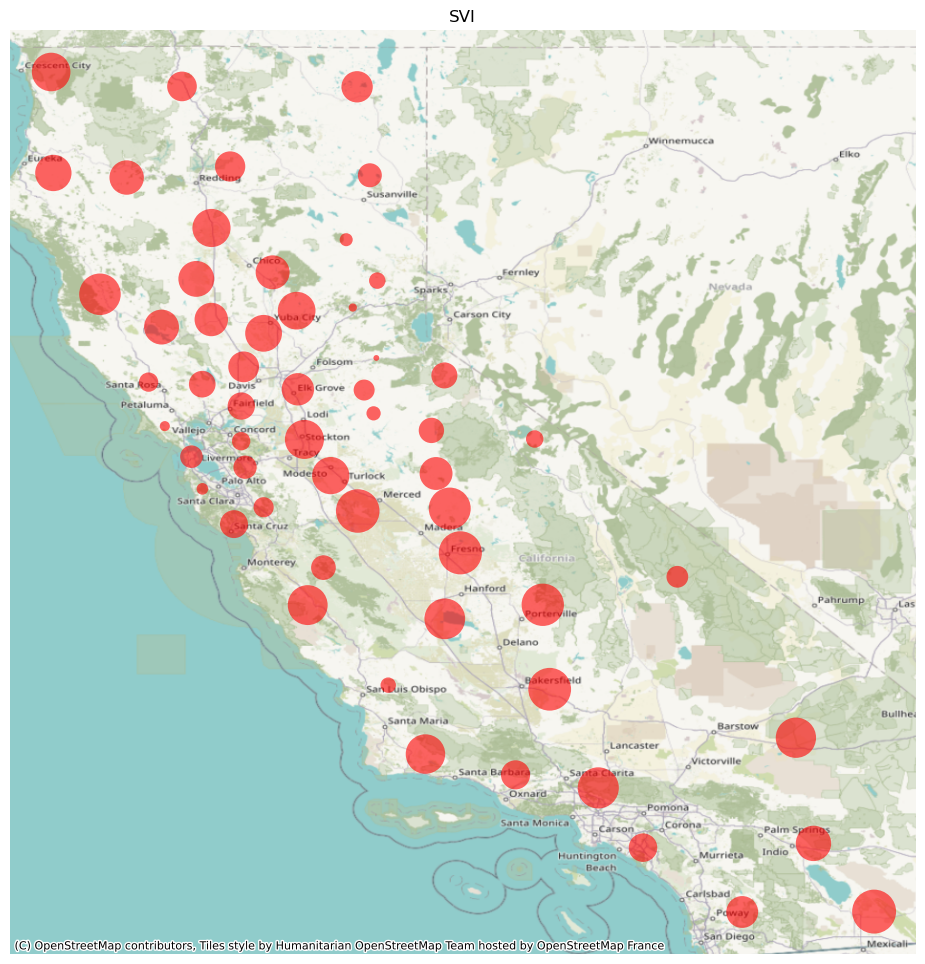

In [33]:
# This is a simple example; adjust this calculation as needed for your data visualization needs
scaling_factor = 1000 / mapping2['RPL_THEMES'].max()  # Example: scaling to make the largest circle have a size of 100

# Start the plot
fig, ax = plt.subplots(figsize=(12, 12))

# Plot using scatter, using 'latitude' and 'longitude' for positions
scatter = ax.scatter(mapping2['longitude'], mapping2['latitude'], s=mapping2['RPL_THEMES'] * scaling_factor, c='red', alpha=0.6, edgecolors='none')

# Assuming mapping2 is already in epsg:4326 for adding the basemap
# Add a basemap
ctx.add_basemap(ax, crs="EPSG:4326") 

# Turn the axes off
ax.axis('off')

# Give it a title
ax.set_title('SVI')

In [34]:
m3 = folium.Map(location=[36.7783, -119.4179], zoom_start=9, tiles='CartoDB positron')

# Create a color map
linear = cm.linear.BuPu_09.scale(mapping['classified'].min(), mapping['classified'].max())
m3.add_child(linear)

# Function to assign color to each feature
def style_function(feature):
    classified_val = mapping.loc[mapping['County_FIPS_ID'] == feature['properties']['County_FIPS_ID'], 'classified'].values[0]
    return {
        'fillColor': linear(classified_val),
        'color': 'black',
        'weight': 0.1,
        'fillOpacity': 0.5,
        'opacity': 0.8,
    }

# Add choropleth layer using the GeoJSON representation and the style function
folium.GeoJson(
    mapping.to_json(),
    style_function=style_function,
    name='choropleth'
).add_to(m3)

for index, row in mapping2.iterrows():
    # Calculate the scaled radius for each circle
    scaled_radius = row['RPL_THEMES'] * 10000
    
    # Add a circle marker to the map
    folium.Circle(
        location=(row['latitude'], row['longitude']),
        radius=scaled_radius,  # This sets the radius in meters; adjust your scaling factor as needed
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.6,
    ).add_to(m3)
m3

In [35]:
m3.save('WILDFIRE_PE_SVI.html')

In [41]:
file_path = 'WILDFIRE_PE_SVI.html'
link = f'<a href="{file_path}" target="_blank">Open WILDFIRE_PE_SVI.html</a>'

# Display the clickable link in the Jupyter Notebook
HTML(link)

# Regression analyses

In [36]:
pip install statsmodels

Note: you may need to restart the kernel to use updated packages.


In [37]:
import numpy as np
import plotly.express as px
import plotly.graph_objects as go

In [38]:
import statsmodels.api as sm

# Imput 'mapping' as the DataFrame
X = mapping['RPL_THEMES']
y = mapping['THREEPLANS_TOTAL']
X = sm.add_constant(X)  # Adds a constant term to the predictor
model = sm.OLS(y, X).fit()

/tmp/ipykernel_1133/589807579.py:6: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



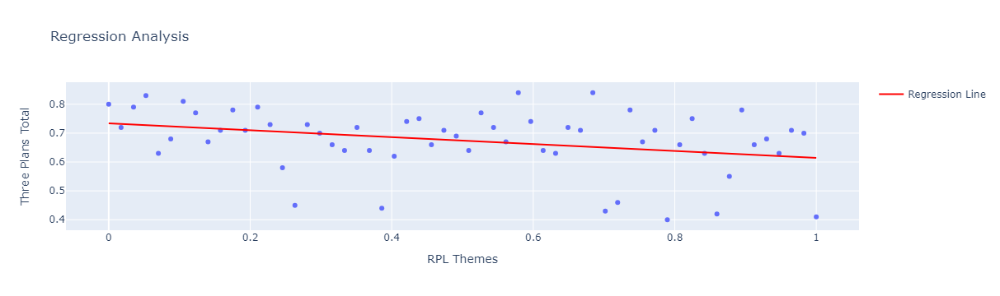

In [39]:
# Plot original data points
fig = px.scatter(mapping, x='RPL_THEMES', y='THREEPLANS_TOTAL', labels={'RPL_THEMES': 'RPL Themes', 'THREEPLANS_TOTAL': 'Three Plans Total'}, title='Regression Analysis')

# Calculate values for the regression line
x_range = np.linspace(mapping['RPL_THEMES'].min(), mapping['RPL_THEMES'].max(), 100)
y_range = model.params[0] + model.params[1] * x_range

# Add the regression line to the figure
fig.add_trace(go.Scatter(x=x_range, y=y_range, name='Regression Line', mode='lines', line=dict(color='red')))

# Show the plot
fig.show()

In [40]:
# print the stats result
X = mapping[['RPL_THEMES']]  # Independent variable
y = mapping['THREEPLANS_TOTAL']  # Dependent variable

# Add a constant to the independent variable
X = sm.add_constant(X)

# Create and fit the model
model = sm.OLS(y, X).fit()

# Print the summary to get regression results
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:       THREEPLANS_TOTAL   R-squared:                       0.104
Model:                            OLS   Adj. R-squared:                  0.088
Method:                 Least Squares   F-statistic:                     6.484
Date:                Mon, 12 Feb 2024   Prob (F-statistic):             0.0137
Time:                        21:57:35   Log-Likelihood:                 49.091
No. Observations:                  58   AIC:                            -94.18
Df Residuals:                      56   BIC:                            -90.06
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.7343      0.027     26.812      0.0

# Findings

### Most CA counties have a way PE higher score in HMP than GP and CWPP. 

HMP’s planning mechanism nature. HMP is a specified plan for natural hazard mitigation. The plan structure and items are developed specifically for all kinds of natural hazards. Wildfire, as one of the most common natural hazards in California, is less likely to be overlooked or omitted in HMPs.
 
Better guideline development of HMP. The HMP guidelines not only provide a clear framework showing all the required items but also give a checklist to help each state, county, or community self-review the required items104)


### SVI does not impact PE.

SVI has a weak correlation to PE (R² = 0.104)